
# population_prefecture_example
## Notebook showing how to use japandata.population.data.prefecture_pop_df
### Author: Sam Passaglia


In [1]:
import os

PLOT_FOLDER = os.path.join(os.getcwd(),'population_prefecture_output/')
output_filetypes = ['pdf']
os.makedirs(PLOT_FOLDER, exist_ok=True)

## Population data at the prefecture level is available in a dataframe

In [2]:
from japandata.population.data import prefecture_pop_df as pref_df

In [3]:
pref_df.dtypes

prefecture                          object
year                                 int64
men                                float64
women                              float64
total-pop                          float64
households                         float64
code                                object
in-minus-out                       float64
moved-out-international            float64
social-in-minus-social-out         float64
moved-in-domestic                  float64
moved-in                           float64
born                               float64
total-pop-corrected                float64
in-minus-out-rate                  float64
moved-out-domestic                 float64
born-minus-died                    float64
moved-out                          float64
total-out                          float64
social-in-minus-social-out-rate    float64
other-out                          float64
households-corrected               float64
total-in                           float64
moved-in-in

### Every row has information for a given year and prefecture 

In [4]:
pref_df.head()

,prefecture,year,men,women,total-pop,households,code,in-minus-out,moved-out-international,social-in-minus-social-out,...,moved-out,total-out,social-in-minus-social-out-rate,other-out,households-corrected,total-in,moved-in-international,born-minus-died-rate,other-in,died
0,三重県,1967,753526.0,808005.0,1561531.0,380573.0,24,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,三重県,1968,748034.0,801946.0,1549980.0,385180.0,24,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,三重県,1969,748980.0,800664.0,1549644.0,399797.0,24,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,三重県,1970,754160.0,803061.0,1557221.0,407278.0,24,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,三重県,1971,761789.0,809222.0,1571011.0,416257.0,24,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
pref_df.tail()

,prefecture,year,men,women,total-pop,households,code,in-minus-out,moved-out-international,social-in-minus-social-out,...,moved-out,total-out,social-in-minus-social-out-rate,other-out,households-corrected,total-in,moved-in-international,born-minus-died-rate,other-in,died
2533,鹿児島県,2016,785168.0,882835.0,1668003.0,807169.0,46,-11499.0,1474.0,-3666.0,...,66699.0,89130.0,-0.218279,842.0,NaN,77631.0,2150.0,-0.466388,743.0,21589.0
2534,鹿児島県,2017,779998.0,875890.0,1655888.0,807682.0,46,-12115.0,1566.0,-3592.0,...,66081.0,88605.0,-0.215347,776.0,NaN,76490.0,2446.0,-0.510970,668.0,21748.0
2535,鹿児島県,2018,774930.0,868507.0,1643437.0,808564.0,46,-12451.0,1738.0,-3504.0,...,65983.0,88902.0,-0.211609,953.0,NaN,76451.0,2834.0,-0.540314,632.0,21966.0
2536,鹿児島県,2019,769447.0,860699.0,1630146.0,809530.0,46,-13291.0,2046.0,-3636.0,...,66378.0,88930.0,-0.221244,924.0,NaN,75639.0,3349.0,-0.587488,628.0,21628.0
2537,鹿児島県,2020,764241.0,853609.0,1617850.0,810817.0,46,-12296.0,1146.0,-2575.0,...,61613.0,83923.0,-0.157961,912.0,NaN,71627.0,1903.0,-0.596327,935.0,21398.0


For some purposes it is convenient to use an xarray instead of a pandas dataframe

In [6]:
pref_arr =  pref_df.set_index(['prefecture', 'year']).to_xarray()

 ## Matplotlib + Interactive Plotly Figures

In [7]:
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import numpy as np
try:
    ## Load my helper plotting module if it is available
    from samplot.utils import init_plotting
except ImportError():
    def init_plotting(**_): return plt.subplots()

### Total Pop vs Time

In [8]:
fig, ax = init_plotting(style='nyt')
title_string = r"Population By Prefecture"
subtitle_string = r"(1m people)"
ax.set_title(subtitle_string, x=0., y=1.0, fontsize=14,ha='left',va='bottom')
fig.suptitle(title_string, x=0,y=1.15, fontsize=18,ha='left',va='bottom', transform=ax.transAxes)
ax.set_xlim(min(pref_arr.year)-.5,max(pref_arr.year)+.5)
for prefecture in pref_arr.prefecture:
    ax.plot(pref_arr.year,pref_arr.loc[{'prefecture':prefecture}]['total-pop']/10**6 )
for suffix in output_filetypes:
    fig.savefig(PLOT_FOLDER+'population_vs_time.'+suffix, transparent=True)

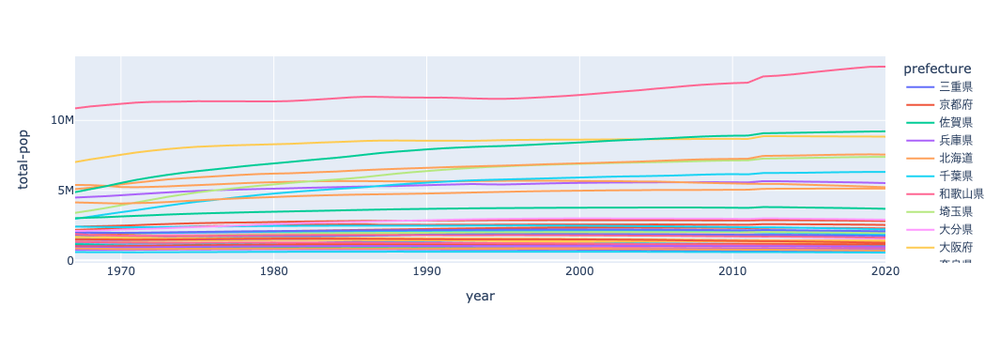

In [9]:
fig = px.line(pref_df, x='year',y='total-pop', color='prefecture', hover_data=['prefecture'])
fig.write_html(PLOT_FOLDER+'population_vs_time.html')
fig

#### Annual Growth vs Time ######

In [10]:
fig, ax = init_plotting(style='nyt')
title_string = r"Annual Growth By Prefecture"
subtitle_string = r"Fractional"
ax.set_title(subtitle_string, x=0., y=1.0, fontsize=14,ha='left',va='bottom')
fig.suptitle(title_string, x=0,y=1.15, fontsize=18,ha='left',va='bottom', transform=ax.transAxes)
ax.set_xlim(min(pref_arr.year)-.5,max(pref_arr.year)+.5)
for prefecture in pref_arr.prefecture:
    ax.plot(pref_arr.year[1:],(pref_arr.loc[{'prefecture':prefecture}]['total-pop'].values[1:]-pref_arr.loc[{'prefecture':prefecture}]['total-pop'].values[:-1])/pref_arr.loc[{'prefecture':prefecture}]['total-pop'].values[1:] )
for suffix in output_filetypes:
    fig.savefig(PLOT_FOLDER+'growth_vs_time.'+suffix, transparent=True)

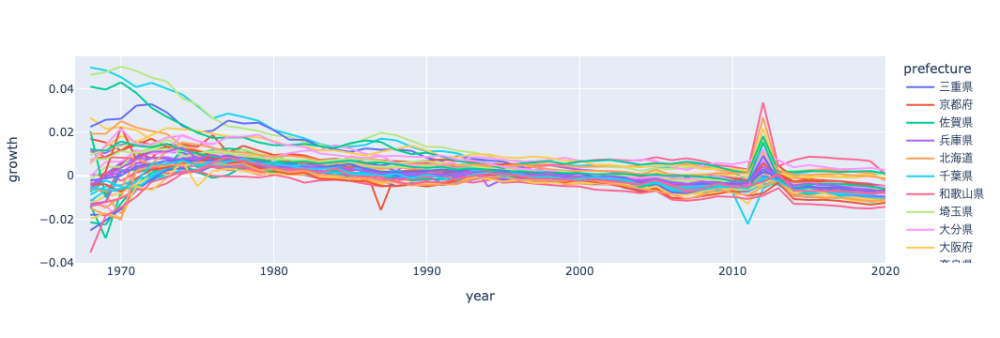

In [11]:
dftemp = pref_arr.to_dataframe().reset_index().fillna(value=np.nan)
dftemp['growth'] = np.nan
for prefecture in np.unique(dftemp['prefecture']):
    dftemp.loc[(dftemp['prefecture']==prefecture) & (dftemp['year'].isin(pref_arr.year.values[1:])),'growth'] = (pref_arr.loc[{'prefecture':prefecture}]['total-pop'].values[1:]-pref_arr.loc[{'prefecture':prefecture}]['total-pop'].values[:-1])/pref_arr.loc[{'prefecture':prefecture}]['total-pop'].values[1:] 
pref_df = dftemp
fig = px.line(pref_df, x='year',y='growth', color='prefecture', hover_data=['prefecture'])
fig.write_html(PLOT_FOLDER+'growth_vs_time.html')
fig

# Population vs Growth ###

In [12]:
fig, ax = init_plotting(style='nyt')
title_string = r"Growth vs Population "
subtitle_string = r"Fractional Population Change vs Population (Million People)"
ax.set_title(subtitle_string, x=0., y=1.0, fontsize=14,ha='left',va='bottom')
ax.set_xlim([0,15])
fig.suptitle(title_string, x=0,y=1.15, fontsize=18,ha='left',va='bottom', transform=ax.transAxes)
year1 = 2020
year2 = 2019
for prefecture in pref_arr.prefecture:
    ax.scatter(pref_arr.loc[{'prefecture':prefecture, 'year':year1}]['total-pop']/10**6,(pref_arr.loc[{'prefecture':prefecture, 'year':year1}]['total-pop']-pref_arr.loc[{'prefecture':prefecture, 'year':year1-1}]['total-pop'])/pref_arr.loc[{'prefecture':prefecture, 'year':year1}]['total-pop'])
for suffix in output_filetypes:
    fig.savefig(PLOT_FOLDER+'growth_vs_pop.'+suffix, transparent=True)

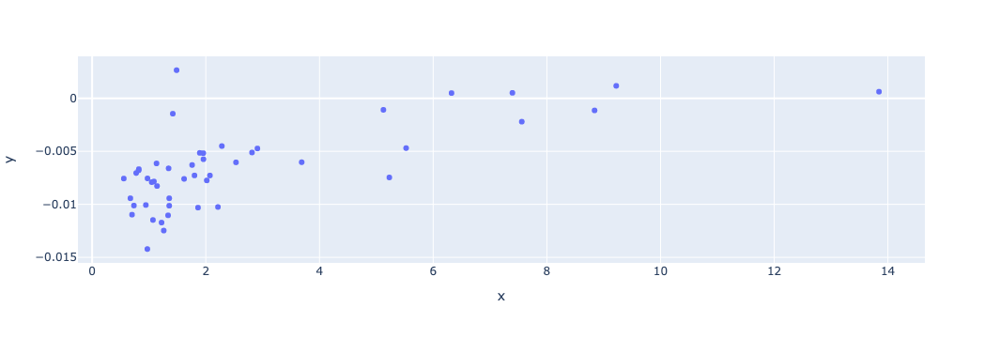

In [13]:
fig = px.scatter(x=pref_arr.loc[{'year':year1}]['total-pop']/10**6,y=(pref_arr.loc[{'year':year1}]['total-pop']-pref_arr.loc[{ 'year':year1-1}]['total-pop'])/pref_arr.loc[{ 'year':year1}]['total-pop'], hover_data={'prefecture':pref_arr.prefecture.values})
fig.write_html(PLOT_FOLDER+'growth_vs_pop.html')
fig

# Birth vs Death ###

In [14]:
fig, ax = init_plotting(style='nyt')
title_string = r"Birth Rate vs Death Rate "
ax.set_xlim([0,15])
fig.suptitle(title_string, x=0,y=1.15, fontsize=18,ha='left',va='bottom', transform=ax.transAxes)
year = 2020
ax.set_xlim([0.005,0.0105])
for prefecture in pref_arr.prefecture:
    ax.scatter((pref_arr.loc[{'prefecture':prefecture, 'year':year}]['born']/pref_arr.loc[{'prefecture':prefecture, 'year':year}]['total-pop']).values,(pref_arr.loc[{'prefecture':prefecture, 'year':year}]['died']/pref_arr.loc[{'prefecture':prefecture, 'year':year}]['total-pop']))
ax.set_xlabel("Birth Rate")
ax.set_ylabel("Death Rate")
for suffix in output_filetypes:
    fig.savefig(PLOT_FOLDER+'birth_vs_death.'+suffix, transparent=True)

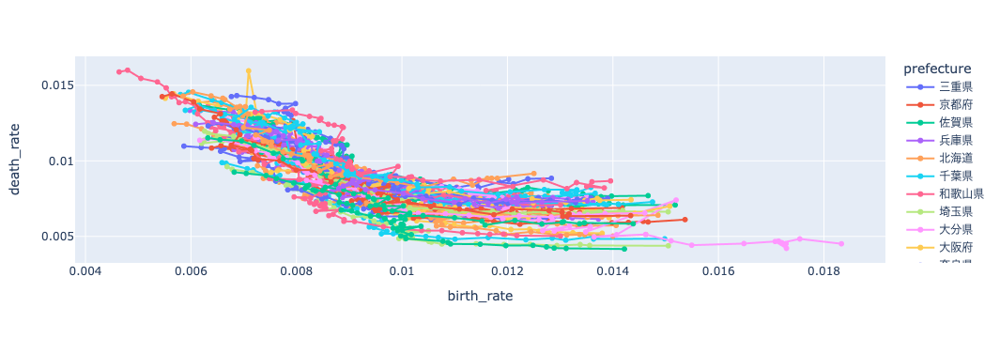

In [15]:
temp_df = pref_df[['born','died','prefecture','year']]
temp_df = temp_df.assign(birth_rate = temp_df['born'].divide(pref_df['total-pop']))
temp_df = temp_df.assign(death_rate = temp_df['died'].divide(pref_df['total-pop']))
fig = px.line(temp_df, x="birth_rate", y="death_rate", color="prefecture", text="year")
fig.write_html(PLOT_FOLDER+'birth_vs_death.html')
fig

# Folium Interactive Maps 

In [16]:
import folium
from folium.features import GeoJsonTooltip
from branca.colormap import linear
from japandata.maps.data import load_map

unhighlighted_style = {
"color": "black",
"weight": 1,
"fillOpacity": 1,
}

highlighted_style = unhighlighted_style | {'weight':4}

map_style = {'location':[35.67, 139], 'zoom_start':5, 'tiles':'None','attr':" "}

mapyear = 2020
map_df = load_map(mapyear,'prefecture')
df = pref_df.loc[pref_df['year']==mapyear]

## Folium: Prefecture Map Natural Decline Rate 

In [17]:
df['natural-decline-rate'] = -df['born-minus-died-rate']

datacolumn= "natural-decline-rate"
datacolumnalias = "Annual Natural Population Decline Per 100 People"
scalingfactor = 1

map_df[datacolumn] = 0
for i in range(len(map_df)):
    try: 
        map_df.loc[i, datacolumn] =  (df.loc[df['code'] == map_df.loc[i,'code'],datacolumn].values[0]/scalingfactor)
    except IndexError: 
        print(map_df.loc[i,'code'])

largestdeviation = np.max(np.abs(map_df[datacolumn]))

colormap = linear.OrRd_09.scale(
    vmin=0, vmax=largestdeviation
)

m = folium.Map(**map_style)

tooltip = GeoJsonTooltip(
    fields=["prefecture", datacolumn],
    aliases=["Prefecture:", datacolumnalias + ':'],
    localize=True,
    sticky=False,
    labels=True,
    style="""
        background-color: #F0EFEF;
        border: 2px solid black;
        border-radius: 3px;
        box-shadow: 3px;
    """,
    max_width=800,
)

def fillColor(feature):
    try: 
        return colormap(feature["properties"][datacolumn]) 
    except ValueError: 
        return 'black'
    except KeyError:
        return 'black'

folium.GeoJson(map_df
,name = datacolumn
,style_function=lambda feature: 
{'fillColor':fillColor(feature)} | unhighlighted_style
,highlight_function=lambda feature: 
{'fillColor':fillColor(feature)} | highlighted_style
,zoom_on_click=True
,tooltip=tooltip
).add_to(m)

colormap.caption = datacolumnalias
colormap.add_to(m)

m.save(PLOT_FOLDER+"naturaldeclinerate.html")
m

/var/folders/11/j3g79k457_3bn3y771_l47fr0000gn/T/ipykernel_3295/659701180.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## Folium: Prefecture Map Migration Rate 

In [18]:
datacolumn= "social-in-minus-social-out-rate"
datacolumnalias = "Migration per 100 People"
scalingfactor = 1

map_df[datacolumn] = 0
for i in range(len(map_df)):
    try: 
        map_df.loc[i, datacolumn] =  (df.loc[df['code'] == map_df.loc[i,'code'],datacolumn].values[0]/scalingfactor)
    except IndexError: 
        print(map_df.loc[i,'code'])

largestdeviation = np.max(np.abs(map_df[datacolumn]))

colormap = linear.RdBu_11.scale(
    vmin=-largestdeviation, vmax=largestdeviation
)

m = folium.Map(**map_style)

tooltip = GeoJsonTooltip(
    fields=["prefecture", datacolumn],
    aliases=["Prefecture:", datacolumnalias + ':'],
    localize=True,
    sticky=False,
    labels=True,
    style="""
        background-color: #F0EFEF;
        border: 2px solid black;
        border-radius: 3px;
        box-shadow: 3px;
    """,
    max_width=800,
)

def fillColor(feature):
    try: 
        return colormap(feature["properties"][datacolumn]) 
    except ValueError: 
        print(feature["properties"]["name"])
        return 'black'
    except KeyError:
        print(feature["properties"]["name"])
        return 'black'

folium.GeoJson(map_df
,name = datacolumn
,style_function=lambda feature: 
{'fillColor':fillColor(feature)} | unhighlighted_style
,highlight_function=lambda feature: 
{'fillColor':fillColor(feature)} | highlighted_style
,zoom_on_click=True
,tooltip=tooltip
).add_to(m)

colormap.caption = datacolumnalias
colormap.add_to(m)

m.save(PLOT_FOLDER+"migration.html")
m

# Maps can also be made in plotly  

/var/folders/11/j3g79k457_3bn3y771_l47fr0000gn/T/ipykernel_3295/3255767329.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



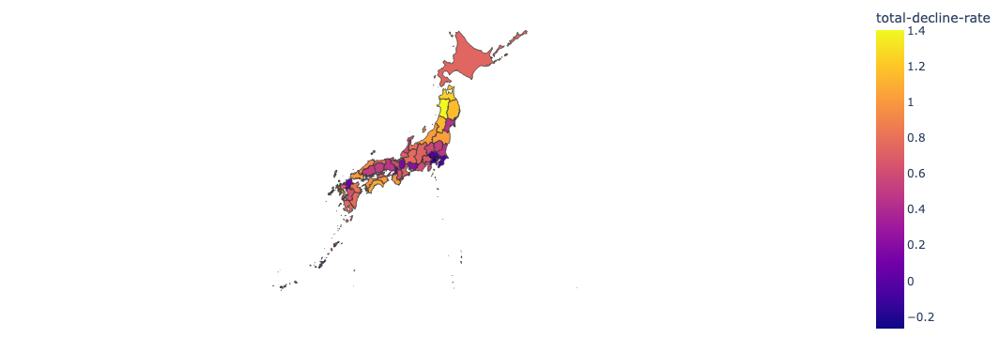

In [19]:
df['total-decline-rate'] = -df['in-minus-out-rate']

datacolumn= "total-decline-rate"
datacolumnalias = "Annual Population Decline Per 100 People"
scalingfactor = 1

map_df[datacolumn] = 0
for i in range(len(map_df)):
    try: 
        map_df.loc[i, datacolumn] =  (df.loc[df['code'] == map_df.loc[i,'code'],datacolumn].values[0]/scalingfactor)
    except IndexError: 
        print(map_df.loc[i,'prefecture'])

fig = px.choropleth(map_df, geojson=map_df.geometry, color=datacolumn,
                    locations=map_df.index, 
                    projection="mercator"
                   )
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.write_html(PLOT_FOLDER+'total_decline.html')

fig

# Or in Matplotlib

 See https://geopandas.org/en/stable/gallery/plotting_with_geoplot.html

In [20]:
datacolumn= "total-decline-rate"
datacolumnalias = "Annual Population Decline Per 100 People"
scalingfactor = 1

map_df[datacolumn] = 0
for i in range(len(map_df)):
    try: 
        map_df.loc[i, datacolumn] =  (df.loc[df['code'] == map_df.loc[i,'code'],datacolumn].values[0]/scalingfactor)
    except IndexError: 
        print(map_df.loc[i,'prefecture'])

fig, ax  = init_plotting()
map_df.plot(column=datacolumn, ax=ax)
fig.savefig(PLOT_FOLDER+'total_decline_mpl.pdf')

In [21]:
plt.close('all')